# 1) To set up your own data cleaning pipeline

In [1]:
#Load the datasets
def read_dataset(name): #when only one dataset is provided as input
    import pandas as pd
    if name == "gpsa":
        df = pd.read_csv('../datasets/googleplaystore.csv', sep=',', encoding ='ISO-8859-1')
    elif name == "gpsu":
        df = pd.read_csv('../datasets/googleplaystore_reviews.csv', sep=',',encoding = 'ISO-8859-1')  
    elif name == "titanic":
        df = pd.read_csv('../datasets/titanic/titanic_train.csv', sep=',', encoding ='ISO-8859-1')
    elif name == "house":
        df = pd.read_csv('../datasets/house/house_train.csv', sep=',', encoding ='ISO-8859-1')
    else: 
        raise ValueError('Invalid dataset name')               
    return df


In [2]:
read_dataset("titanic")

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...,...
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.0000,NaN,S
887,888,1,1,"Graham, Miss. Margaret Edith",female,19.0,0,0,112053,30.0000,B42,S
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.4500,NaN,S
889,890,1,1,"Behr, Mr. Karl Howell",male,26.0,0,0,111369,30.0000,C148,C


## - Loading your data

In [3]:
import learn2clean.loading.reader as rd 
import learn2clean.normalization.normalizer as nl 
import pandas as pd

# executing profiling function for one dataset as input
rd.profile_summary(read_dataset('titanic'), plot=False)


Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId    int64                  0.0               891.0                   0      -1.2
1      Survived    int64                  0.0                 2.0            0.477717  -1.77179
2        Pclass    int64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp    int64                  0.0                 7.0             3.68913   17.7735
5         Parch    int64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object                  0.0                 2.0                 N/A       N/A
9        Ticket   obj

In [4]:

read_dataset('titanic')['Survived'].head() # the target variable is categorical (bool)


0    0
1    1
2    1
3    1
4    0
Name: Survived, dtype: int64

In [5]:

# no encoding on the target variable
d_not_enc = rd.Reader(sep=',',verbose=True, encoding=False) 

# when you have two datasets as inputs: train and test datasets
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
titanic_not_encoded['train'].head()


Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 5.065268039703369 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object   

,Age,Cabin,Embarked,Fare,Name,Parch,PassengerId,Pclass,Sex,SibSp,Ticket
0,22.0,NaN,S,7.2500,"Braund, Mr. Owen Harris",0.0,1.0,3.0,male,1.0,A/5 21171
1,38.0,C85,C,71.2833,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",0.0,2.0,1.0,female,1.0,PC 17599
2,26.0,NaN,S,7.9250,"Heikkinen, Miss. Laina",0.0,3.0,3.0,female,0.0,STON/O2. 3101282
3,35.0,C123,S,53.1000,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",0.0,4.0,1.0,female,1.0,113803
4,35.0,NaN,S,8.0500,"Allen, Mr. William Henry",0.0,5.0,3.0,male,0.0,373450


In [6]:

# otherwise for only one dataset as input, 
# train_test_split function will split the input dataset into train/test dataset
titanic_train_only  = ["../datasets/titanic/titanic_train.csv"]
titanic_train_only_not_encoded = d_not_enc.train_test_split(titanic_train_only, 'Survived')
titanic_train_only_not_encoded['train'].head() 


Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.059873104095458984 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
161,162.0,1.0,2.0,"Watt, Mrs. James (Elizabeth ""Bessie"" Inglis Milne)",female,40.0,0.0,0.0,C.A. 33595,15.7500,NaN,S
16,17.0,0.0,3.0,"Rice, Master. Eugene",male,2.0,4.0,1.0,382652,29.1250,NaN,Q
594,595.0,0.0,2.0,"Chapman, Mr. John Henry",male,37.0,1.0,0.0,SC/AH 29037,26.0000,NaN,S
42,43.0,0.0,3.0,"Kraeff, Mr. Theodor",male,NaN,0.0,0.0,349253,7.8958,NaN,C
95,96.0,0.0,3.0,"Shorney, Mr. Charles Joseph",male,NaN,0.0,0.0,374910,8.0500,NaN,S


## - Normalize your data

In [7]:
# >> Examples of normalization
# The choice for the normalizer : 'ZS', 'MM','DS' or 'Log10'
#    Available strategies=
#       - 'ZS' z-score normalization
#       - 'MM' MinMax scaling
#       - 'DS' decimal scaling
#       - 'Log10 log10 scaling

import learn2clean.normalization.normalizer as nl 

# MM normalization with exclude = None, all numeric variables will be normalized
n1= nl.Normalizer(titanic_not_encoded.copy(),strategy='MM',exclude=None, verbose =False)
print('"Fare" original variable\n',titanic_not_encoded['train']['Fare'].head())
print('"Fare" normalized variable\n', n1.transform()['train']['Fare'].head())


"Fare" original variable
 0     7.2500
1    71.2833
2     7.9250
3    53.1000
4     8.0500
Name: Fare, dtype: float64
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.027189970016479492 seconds

"Fare" normalized variable
 0    0.014151
1    0.139136
2    0.015469
3    0.103644
4    0.015713
Name: Fare, dtype: float64


In [8]:

#ZS normalization
n3= nl.Normalizer(titanic_not_encoded.copy(),strategy='ZS',exclude=None, verbose = False)
print('ZS normalized variables\n',n3.transform()['train'].head())

#DS scaling
n4= nl.Normalizer(titanic_not_encoded.copy(),strategy='DS',exclude=None, verbose = False)
print('DS normalized variables\n',n4.transform()['train'].head())

#Log10 scaling
n5= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude=None, verbose = False)
#print('Log10 normalized variables\n',n5.transform()['train'].head())
print('Log10 normalized variables none excluded in train dataset\n',n5.transform()['train']['Fare'].head())
print('Log10 normalized variables none excluded in test dataset\n',n5.transform()['test']['Fare'].head())

#Log10 scaling  excluding target variable 'Fare'
n6= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude='Fare',verbose = False)

print("Log10 normalized variables 'Fare' excluded in train dataset \n",n6.transform()['train']['Fare'].head())
print("Log10 normalized variables 'Fare' excluded  in test dataset \n",n6.transform()['test']['Fare'].head())

n7= nl.Normalizer(titanic_not_encoded.copy(),strategy='Log10',exclude='Fare', verbose = False)
print('Log10 normalized variables none excluded\n', n5.transform()['train']['Fare'].head())
print("Log10 normalized variables 'Pclass' excluded\n")
n7.transform()['train']['Pclass'].head()
# here Pclass is not excluded from normalization!



>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.027383804321289062 seconds

ZS normalized variables
         Age      Fare     Parch  PassengerId    Pclass     SibSp Cabin  \
0 -0.530005 -0.502163 -0.473408    -1.729137  0.826913  0.432550   NaN   
1  0.571430  0.786404 -0.473408    -1.725251 -1.565228  0.432550   C85   
2 -0.254646 -0.488580 -0.473408    -1.721365  0.826913 -0.474279   NaN   
3  0.364911  0.420494 -0.473408    -1.717480 -1.565228  0.432550  C123   
4  0.364911 -0.486064 -0.473408    -1.713594  0.826913 -0.474279   NaN   

  Embarked                                                 Name     Sex  \
0        S                              Braund, Mr. Owen Harris    male   
1        C  Cumings, Mrs. John Bradley (Florence Briggs Thayer)  female   
2        S                               Heikkinen, Miss. Laina  female   
3        S         Futrelle, Mrs. Jacques Heath (Lily May Peel)  female   
4 

0    1.0
1    1.0
2    1.0
3    1.0
4    1.0
Name: Pclass, dtype: float64

In [9]:
# To prevent that and avoid normalization for more than one numeric variables, 
# please change the data type into 'object' data type right after loading 
# and before normalization and learn2clean pipeline

titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')

titanic_not_encoded['train']['Pclass'] = titanic_not_encoded['train']['Pclass'].astype('object')
titanic_not_encoded['train']['PassengerId'] = titanic_not_encoded['train']['PassengerId'].astype('object')
titanic_not_encoded['train']['SibSp'] = titanic_not_encoded['train']['SibSp'].astype('object')
titanic_not_encoded['train']['Parch'] = titanic_not_encoded['train']['Parch'].astype('object')

titanic_not_encoded['test']['Pclass'] = titanic_not_encoded['test']['Pclass'].astype('object')
titanic_not_encoded['test']['PassengerId'] = titanic_not_encoded['test']['PassengerId'].astype('object')
titanic_not_encoded['test']['SibSp'] = titanic_not_encoded['test']['SibSp'].astype('object')
titanic_not_encoded['test']['Parch'] = titanic_not_encoded['test']['Parch'].astype('object')

normalized_titanic = nl.Normalizer(titanic_not_encoded.copy(),strategy='DS',exclude='Age', verbose = False).transform()
normalized_titanic['train'].head()




Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.057214975357055664 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object

,Age,Fare,Cabin,Embarked,Name,Parch,PassengerId,Pclass,Sex,SibSp,Ticket
0,22.0,0.103943,NaN,S,"Braund, Mr. Owen Harris",0,1,3,male,1,A/5 21171
1,38.0,0.869598,C85,C,"Cumings, Mrs. John Bradley (Florence Briggs Thayer)",0,2,1,female,1,PC 17599
2,26.0,0.222222,NaN,S,"Heikkinen, Miss. Laina",0,3,3,female,0,STON/O2. 3101282
3,35.0,0.817049,C123,S,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",0,4,1,female,1,113803
4,35.0,0.227696,NaN,S,"Allen, Mr. William Henry",0,5,3,male,0,373450


## - Replace missing values

In [10]:
#>> Examples for missing value imputation
# Available strategies:
#            - 'EM': only for numerical variables; imputation based on
#                expectation maximization
#            - 'MICE': only for numerical variables  missing at random (MAR);
#                Multivariate Imputation by Chained Equations
#            - 'KNN', only for numerical variables; k-nearest neighbor
#                imputation (k=4) which weights samples using the mean squared
#                difference on features for which two rows both have observed
#                data
#            - 'RAND', 'MF': both for numerical and categorical variables;
#                replace missing values by randomly selected value in the 
#                variable domain or by the most frequent value in the variable
#                domain respectively
#            - 'MEAN', 'MEDIAN': only for numerical variables; replace missing
#                values by mean or median of the numerical variable respectvely
#            - or 'DROP' remove the row with at least one missing value

import learn2clean.imputation.imputer as imp

# replace missing values by the most frequent ones in the training and testing datasets

print('Number of missing values',normalized_titanic['train'].isnull().sum().sum()) 
imp1 = imp.Imputer(normalized_titanic.copy(),strategy='MF', verbose=True).transform()
imp2 = imp.Imputer(normalized_titanic.copy(),strategy='RAND', verbose=True).transform()
imp3 = imp.Imputer(normalized_titanic.copy(),strategy='DROP', verbose=True).transform()
imp4 = imp.Imputer(normalized_titanic.copy(),strategy='MEAN', verbose=True).transform() # for Age only numerical variable with missing values
imp5 = imp.Imputer(normalized_titanic.copy(),strategy='KNN', verbose=True).transform()
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='MEDIAN', verbose=True).transform() # for Age only numerical variable with missing values
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='EM', verbose=True).transform()
imp6 = imp.Imputer(normalized_titanic.copy(),strategy='MICE', verbose=True).transform()

Number of missing values 866
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
Most frequent value for  Age is: 24.0
Most frequent value for  Fare is: 0.4444444444444444
Most frequent value for  Cabin is: C23 C25 C27
Most frequent value for  Embarked is: S
Most frequent value for  Name is: Allum, Mr. Owen George
Most frequent value for  Parch is: 0.0
Most frequent value for  PassengerId is: 891.0
Most frequent value for  Pclass is: 3.0
Most frequent value for  Sex is: male
Most frequent value for  SibSp is: 0.0
Most frequent value for  Ticket is: 1601
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical mi

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.8196060657501221 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in 

## - Detect outliers and remove them

In [11]:
# >> Examples for outlier detection and removal
# Available strategies =
#            'ZS': detects outliers using the robust Zscore as a function
#            of median and median absolute deviation (MAD)
#            'IQR': detects outliers using Q1 and Q3 +/- 1.5*InterQuartile Range
#            'LOF': detects outliers using Local Outlier Factor

                
import learn2clean.outlier_detection.outlier_detector as out

#to remove rows having 30% and more ZSB-based outling values among the numerical variables
out1=out.Outlier_detector(titanic_not_encoded.copy(), strategy='ZSB', threshold = .3, verbose=True)
out1.transform()

#to remove rows having at least one IQR-based outlying value using threshold '-1'
out2=out.Outlier_detector(titanic_not_encoded.copy(), strategy='IQR', threshold = -1, verbose=False)
out2.transform()

#to remove rows having 40% and more ZSB-based outling values among the numerical variables; 
# since LOF requires non missing values, rows with NaN are also removed
out3=out.Outlier_detector(titanic_not_encoded.copy(), strategy='LOF', threshold = .4, verbose=False)
out3.transform()



>>Outlier detection and removal:
* For train dataset
232 outlying rows have been removed:
with indexes: [1, 3, 6, 13, 23, 25, 27, 31, 34, 35, 43, 50, 52, 54, 55, 59, 61, 62, 71, 72, 74, 83, 86, 88, 92, 96, 97, 102, 110, 118, 119, 120, 124, 137, 139, 145, 147, 151, 155, 159, 164, 166, 169, 170, 174, 180, 182, 183, 185, 195, 201, 209, 215, 218, 224, 230, 233, 245, 248, 256, 257, 258, 261, 262, 266, 268, 269, 270, 275, 290, 291, 297, 298, 299, 305, 306, 307, 309, 310, 311, 318, 319, 324, 325, 329, 332, 334, 336, 337, 339, 341, 351, 356, 366, 369, 370, 373, 375, 377, 380, 383, 385, 386, 390, 393, 412, 416, 434, 435, 436, 438, 445, 449, 453, 457, 462, 475, 480, 484, 486, 492, 493, 496, 498, 504, 505, 509, 513, 515, 520, 523, 527, 537, 539, 540, 541, 542, 544, 549, 550, 556, 557, 558, 571, 577, 581, 583, 585, 587, 591, 596, 599, 602, 607, 608, 609, 610, 615, 618, 621, 625, 627, 632, 638, 641, 643, 645, 647, 655, 659, 660, 665, 669, 670, 671, 678, 679, 681, 683, 684, 685, 686, 689, 690, 692,

{'train':       Age     Fare        Cabin Embarked  \
 1    38.0  71.2833          C85        C   
 6    54.0  51.8625          E46        S   
 10    4.0  16.7000           G6        S   
 11   58.0  26.5500         C103        S   
 21   34.0  13.0000          D56        S   
 ..    ...      ...          ...      ...   
 871  47.0  52.5542          D35        S   
 872  33.0   5.0000  B51 B53 B55        S   
 879  56.0  83.1583          C50        C   
 887  19.0  30.0000          B42        S   
 889  26.0  30.0000         C148        C   
 
                                                     Name Parch PassengerId  \
 1    Cumings, Mrs. John Bradley (Florence Briggs Thayer)     0           2   
 6                                McCarthy, Mr. Timothy J     0           7   
 10                       Sandstrom, Miss. Marguerite Rut     1          11   
 11                              Bonnell, Miss. Elizabeth     0          12   
 21                                 Beesley, Mr. Lawre

## - Detect duplicates and remove them

In [12]:
# >> Examples for duplicate detection and removal
# titanic has no exact duplicate anyway
# Available strategies =
#        'ED':  exact duplicate detection/removal or
#        'AD':  for aproximate duplicate records detection and removal
#        based on Jaccard similarity 

# import the Duplicate_detector class
import learn2clean.duplicate_detection.duplicate_detector as dup

#Remove exact duplicates with 'ED' strategy of the Duplicate_detector class

dup.Duplicate_detector(titanic_not_encoded.copy(), strategy='ED', verbose=False).transform()

#Remove approximate duplicates with thresholding Jaccard similarity 
# using 'AD'strategy of the Duplicate_detector class
dup.Duplicate_detector(titanic_not_encoded.copy(), strategy='AD', threshold = .3, verbose=False).transform()



>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.009750127792358398 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.4106152057647705 seconds



{'train':       Age Cabin Embarked     Fare  \
 0    22.0   NaN        S   7.2500   
 1    38.0   C85        C  71.2833   
 2    26.0   NaN        S   7.9250   
 3    35.0  C123        S  53.1000   
 4    35.0   NaN        S   8.0500   
 ..    ...   ...      ...      ...   
 886  27.0   NaN        S  13.0000   
 887  19.0   B42        S  30.0000   
 888   NaN   NaN        S  23.4500   
 889  26.0  C148        C  30.0000   
 890  32.0   NaN        Q   7.7500   
 
                                                     Name Parch PassengerId  \
 0                                Braund, Mr. Owen Harris     0           1   
 1    Cumings, Mrs. John Bradley (Florence Briggs Thayer)     0           2   
 2                                 Heikkinen, Miss. Laina     0           3   
 3           Futrelle, Mrs. Jacques Heath (Lily May Peel)     0           4   
 4                               Allen, Mr. William Henry     0           5   
 ..                                                   ...  

## - Detect inconsistencies

In [13]:
# >> Examples for inconsistency detection 
# Available consistency checking strategies :
#            - 'CC': checks whether the data satisfy the constraints
#                specified in a 'file_name'_constraint.tdda stored in 'save' directory
#            - 'PC': checks whether the data satisfy the patterns
#                specified in 'file_name'_patterns.txt stored in 'save' directory

import learn2clean.loading.reader as rd 
d_not_enc = rd.Reader(sep=',',verbose=False, encoding=False)                 
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
                
# import the Consistency_checker class
import learn2clean.consistency_checking.consistency_checker as cc

# discover the constraints from the input (train) dataset and store them in a file entitled 'titanic_discovered'_constraint.tdda in the 'save' directory
#cc.constraint_discovery(read_dataset('titanic'), file_name='titanic_discovered')

# discover the patterns from the input (train) dataset and store them in a file entitled 'titanic_discovered'_patterns.txt in the 'save' directory
#cc.pattern_discovery(read_dataset('titanic'), file_name='titanic_discovered')

# detect pattern violations with respect to a given file of patterns entitled 'titanic_example'__constraint.tdda" stored in the 'save' directory

cc.Consistency_checker(titanic_not_encoded, strategy='CC', file_name='titanic_example',verbose=True).transform()

# detect pattern violations with respect to a given file of patterns entitled 'titanic_example'_patterns.txt" stored in the 'save' directory

cc.Consistency_checker(titanic_not_encoded, strategy='PC', file_name='titanic_example',verbose=True).transform()

>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

FIELDS:

Survived: 5 failures  0 passes  type ✗  min ✗  max ✗  sign ✗  max_nulls ✗

Age: 0 failures  4 passes  type ✓  min ✓  max ✓  sign ✓

Cabin: 0 failures  3 passes  type ✓  min_length ✓  max_length ✓

Embarked: 0 failures  4 passes  type ✓  min_length ✓  max_length ✓  allowed_values ✓

Fare: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

Name: 0 failures  5 passes  type ✓  min_length ✓  max_length ✓  max_nulls ✓  no_duplicates ✓

Parch: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

PassengerId: 0 failures  6 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓  no_duplicates ✓

Pclass: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓  max_nulls ✓

Sex: 0 failures  5 passes  type ✓  min_length ✓  max_length ✓  max_nulls ✓  allowed_values ✓

SibSp: 0 failures  5 passes  type ✓  min ✓  max ✓  sign ✓

{'train': Empty DataFrame
 Columns: [Cabin, Embarked, Name, Sex, Ticket]
 Index: [],
 'test': Empty DataFrame
 Columns: [Cabin, Embarked, Name, Sex, Ticket]
 Index: [],
 'target': 0      0
 1      1
 2      1
 3      1
 4      0
       ..
 886    0
 887    1
 888    0
 889    1
 890    0
 Name: Survived, Length: 891, dtype: int64,
 'target_test': Series([], Name: Survived, dtype: int64)}

## - Select features

In [14]:
# >> Examples for Feature selection
# Available strategies=
#           'MR': using a default threshold on the missing ratio per variable,
#            i.e., variables with 20% (by default) and more missing values
#            are removed
#            'LC': detects pairs of linearly correlated variables and remove one
#            'VAR': uses threshold on the variance
#            'Tree': uses decision tree classification as model for feature
#                selection given the target set for classification task
#                'SVC': uses linear SVC as model for feature selection given
#                 the target set for classification task
#            'WR': uses the selectKbest (k=10) and Chi2 for feature selection
#                given the target set for classification task
#            'L1': uses Lasso L1 for feature selection given the target set for
#                regression task
#            'IMP': uses Random Forest regression for feature selection given
#                the target set for regression task

                
import learn2clean.loading.reader as rd 
import learn2clean.feature_selection.feature_selector as fs
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
d_not_enc = rd.Reader(sep=',',verbose=True, encoding=False) 
titanic_not_encoded = d_not_enc.train_test_split(titanic, 'Survived')
#Available strategies for feature selection 
#        'MR': using a default threshold on the missing ratio per variable, i.e., variables
#                with 20% (by default) and more missing values are removed
#        'LC': detects pairs of linearly correlated variables and remove one
#        'VAR': uses threshold on the variance
#        'Tree': uses decision tree classification as model for feature selection given the target set for classification task
#        'SVC': uses linear SVC as model for feature selection given the target set for classification task
#        'WR': uses the selectKbest (k=10) and Chi2 for feature selection given the target set for classification task
#        'L1': uses Lasso L1 for feature selection given the target set for regression task
#        'IMP': uses Random Forest regression for feature selection given the target set for regression task

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'MR', threshold=0.1, exclude=None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'LC', threshold=0.2,  exclude=None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'L1',  exclude= None, threshold=.3,verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'IMP', exclude = 'SibSp',verbose=True, threshold=.4).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'Tree',  exclude='Pclass',verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'WR', exclude= None, verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'WR', exclude= 'Sex', verbose=True).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'SVC',  exclude=None).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'VAR',  exclude=None).transform()

fs.Feature_selector(dataset = titanic_not_encoded.copy(), strategy= 'VAR',  exclude='Cabin').transform()



Reading csv : titanic_train.csv ...
Reading data ...
CPU time: 0.04798603057861328 seconds
Profiling datasets
      Attribute     Type  Num. Missing Values  Num. Unique Values           Sknewness  Kurtosis
0   PassengerId  float64                  0.0               891.0                   0      -1.2
1      Survived  float64                  0.0                 2.0            0.477717  -1.77179
2        Pclass  float64                  0.0                 3.0           -0.629486  -1.27957
3           Age  float64                177.0                89.0  0.3882898514698658  0.168637
4         SibSp  float64                  0.0                 7.0             3.68913   17.7735
5         Parch  float64                  0.0                 7.0             2.74449   9.71661
6          Fare  float64                  0.0               248.0             4.77925   33.2043
7          Name   object                  0.0               891.0                 N/A       N/A
8           Sex   object 

{'train':       Age     Fare  Parch  PassengerId  Pclass  SibSp Cabin
 0    22.0   7.2500    0.0          1.0     3.0    1.0   NaN
 1    38.0  71.2833    0.0          2.0     1.0    1.0   C85
 2    26.0   7.9250    0.0          3.0     3.0    0.0   NaN
 3    35.0  53.1000    0.0          4.0     1.0    1.0  C123
 4    35.0   8.0500    0.0          5.0     3.0    0.0   NaN
 ..    ...      ...    ...          ...     ...    ...   ...
 886  27.0  13.0000    0.0        887.0     2.0    0.0   NaN
 887  19.0  30.0000    0.0        888.0     1.0    0.0   B42
 888   NaN  23.4500    2.0        889.0     3.0    1.0   NaN
 889  26.0  30.0000    0.0        890.0     1.0    0.0  C148
 890  32.0   7.7500    0.0        891.0     3.0    0.0   NaN
 
 [891 rows x 7 columns],
 'test':       Pclass Cabin      Fare  SibSp  Parch  PassengerId   Age
 0        3.0   NaN    7.2500    1.0    0.0          1.0  22.0
 1        1.0   C85   71.2833    1.0    0.0          2.0  38.0
 2        3.0   NaN    7.9250    0.

## >> Classification 

In [15]:
import learn2clean.classification.classifier as cl
#output is accuracy of classification for k=10 cross-validation and execution time 
#plus a detailed classification report if verbose = True

Cl1 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'LDA', verbose = False).transform()
Cl2 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'MNB',verbose = False).transform()
Cl3 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'NB',verbose = False).transform()
Cl4 = cl.Classifier(dataset = titanic_not_encoded,target = 'Survived',strategy = 'CART',verbose = True).transform()



>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.03586602210998535 seconds

>>Classification task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

Accuracy of Multinomial Naive Bayes classification for 10 cross-validation : 0.653

Classification done -- CPU time: 3.912658929824829 seconds

>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6682511737089201

Classification done -- CPU time: 0.04218006134033203 seconds

>>Classification task
{'mean_fit_time': array([0.00210357, 0.00245903, 0.00272024, 0.00256379, 0.00263033]), 'std_fit_time': array([4.72405824e-06, 5.82927901e-04, 2.97169249e-04, 3.41564967e-05,
       1.56915655e-05]), 'mean_score_time': array([0.00126851, 0.00136428, 0.00131927, 0.00126698, 0.00126336]), 'std_score_time': array([3.83546140e-05, 3.23687091e-04, 9.90370919e-05, 6.72114153e-05,
       2.71484232e-05]), 'param_max_depth': masked_array(data=[3, 5, 7, 9, 10],
             mask=[False, False, False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'max_depth': 3}, {'max_depth': 5}, {'max_depth': 7}, {'max_depth': 9}, {'max_depth': 1

## >> Regression

In [16]:
import learn2clean.regression.regressor as rg
# output is MSE and computation time, with regression summary if verbose = True
rg1 = rg.Regressor(dataset = titanic_not_encoded,target = 'Survived',strategy= 'LASSO', verbose = True).transform()

rg2 = rg.Regressor(dataset = titanic_not_encoded,target = 'Survived',strategy= 'OLS',verbose = True).transform()



>>Regression task
MSE values of cross validation
[[0.33428799 0.19545235 0.27222477 0.25590979 0.26467421 0.24275834
  0.22934358 0.22435433 0.23116173 0.24046703]
 [0.33381358 0.19613092 0.2702665  0.25316562 0.26448743 0.24257295
  0.22936945 0.22496779 0.23169864 0.23734665]
 [0.33336004 0.1972071  0.26855447 0.25059992 0.26438711 0.24251741
  0.22949092 0.22566054 0.23237851 0.2344432 ]
 [0.32786341 0.19956412 0.26645376 0.24709295 0.26439872 0.24267824
  0.22985272 0.2268461  0.23366493 0.23050614]
 [0.32029113 0.20221071 0.26513165 0.24448445 0.26455681 0.24303609
  0.23031892 0.22796896 0.23498205 0.22760982]
 [0.31605777 0.20409598 0.26452545 0.24305575 0.26471675 0.24334843
  0.23067047 0.22870123 0.23587898 0.22603889]
 [0.31469755 0.20477317 0.26435474 0.24260224 0.26507631 0.24357785
  0.23369878 0.22991413 0.23603975 0.2257568 ]
 [0.31170511 0.20394425 0.26067606 0.24021353 0.26580729 0.24317463
  0.2372156  0.23768063 0.23460895 0.2254377 ]
 [0.30984331 0.20400398 0.2586

const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000030
Pclass        -0.242923
SibSp         -0.056734
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0.0,1.0,3.0,1.0
1,1.0,38.0,71.2833,0.0,2.0,1.0,1.0
2,1.0,26.0,7.9250,0.0,3.0,3.0,0.0
3,1.0,35.0,53.1000,0.0,4.0,1.0,1.0
4,1.0,35.0,8.0500,0.0,5.0,3.0,0.0
...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1.0,1301.0,3.0,1.0
1302,1.0,37.0,90.0000,0.0,1303.0,1.0,1.0
1303,1.0,28.0,7.7750,0.0,1304.0,3.0,0.0
1305,1.0,39.0,108.9000,0.0,1306.0,1.0,0.0


(7,)

(1045, 7)

(7,)

(1045, 7)

MODIFICATION
                            OLS Regression Results                            
Dep. Variable:               Survived   R-squared:                       0.195
Model:                            OLS   Adj. R-squared:                  0.188
Method:                 Least Squares   F-statistic:                     28.54
Date:                Thu, 09 Jun 2022   Prob (F-statistic):           1.23e-30
Time:                        12:37:42   Log-Likelihood:                -427.98
No. Observations:                 714   AIC:                             870.0
Df Residuals:                     707   BIC:                             902.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const           1.1796      0.094    

## >> Clustering

In [17]:
import learn2clean.clustering.clusterer as ct
# clustering is applied to one dataset (i.e., the training set if two datasets are given in the path)
# output is silhouette, best k, and computation time, plus the training dataset with cluster IDs

ct.Clusterer(dataset = titanic_not_encoded,strategy= 'KMEANS', verbose=True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'euclidean', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'cosine', verbose = True).transform()
ct.Clusterer(dataset = titanic_not_encoded,strategy='HCA', metric= 'cityblock', verbose = True).transform()



>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.5976  for k= 2
Quality of clustering 0.5976
Labels distribution:
1    363
0    351
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.2590939998626709 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5544
Labels distribution:
1    455
2    256
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.08744335174560547 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5544
Labels distribution:
1    455
2    256
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.0782921314239502 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Best silhouette = 0.5544  for k= 3
Quality of clustering 0.1868
Labels distribution:
1    678
2     18
0     18
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.08734917640686035 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5544  for k= 3
Quality of clustering 0.5935
Labels distribution:
2    358
1    353
0      3
Name: cluster_ID, dtype: int64
Clustering done -- CPU time: 0.08092188835144043 seconds


{'quality_metric': 0.5935,
 'result': {'train':       Age     Fare  Parch  PassengerId  Pclass  SibSp  cluster_ID
  0    22.0   7.2500    0.0          1.0     3.0    1.0           1
  1    38.0  71.2833    0.0          2.0     1.0    1.0           1
  2    26.0   7.9250    0.0          3.0     3.0    0.0           1
  3    35.0  53.1000    0.0          4.0     1.0    1.0           1
  4    35.0   8.0500    0.0          5.0     3.0    0.0           1
  ..    ...      ...    ...          ...     ...    ...         ...
  885  39.0  29.1250    5.0        886.0     3.0    0.0           2
  886  27.0  13.0000    0.0        887.0     2.0    0.0           2
  887  19.0  30.0000    0.0        888.0     1.0    0.0           2
  889  26.0  30.0000    0.0        890.0     1.0    0.0           2
  890  32.0   7.7500    0.0        891.0     3.0    0.0           2
  
  [714 rows x 7 columns],
  'test':        Age Cabin Embarked      Fare  \
  0     22.0   NaN        S    7.2500   
  1     38.0   C85 

## - Create your own pipeline

In [18]:
# create your preprocessing pipeline for classification

import learn2clean.loading.reader as rd 
import learn2clean.normalization.normalizer as nl 
import learn2clean.feature_selection.feature_selector as fs
import learn2clean.duplicate_detection.duplicate_detector as dd
import learn2clean.outlier_detection.outlier_detector as od
import learn2clean.imputation.imputer as imp
import learn2clean.classification.classifier as cl

d_not_enc = rd.Reader(sep=',',verbose=False, encoding=False) 

# when you have two datasets as inputs: train and test datasets
titanic  = ["../datasets/titanic/titanic_train.csv", "../datasets/titanic/test.csv"]
dataset = d_not_enc.train_test_split(titanic, 'Survived')

dataset['train']['Pclass'] = dataset['train']['Pclass'].astype('object')
dataset['train']['PassengerId'] = dataset['train']['PassengerId'].astype('object')
dataset['train']['SibSp'] = dataset['train']['SibSp'].astype('object')
dataset['train']['Parch'] = dataset['train']['Parch'].astype('object')

dataset['test']['Pclass'] = dataset['test']['Pclass'].astype('object')
dataset['test']['PassengerId'] = dataset['test']['PassengerId'].astype('object')
dataset['test']['SibSp'] = dataset['test']['SibSp'].astype('object')
dataset['test']['Parch'] = dataset['test']['Parch'].astype('object')

d1 = fs.Feature_selector(dataset=dataset.copy(),strategy= 'MR', threshold=.3).transform()
d2 = imp.Imputer(d1, strategy = 'MF',verbose=False).transform()
d3 = nl.Normalizer(d2,strategy='DS', exclude='Survived',verbose=False).transform()
d4 = od.Outlier_detector(d3, strategy='LOF', threshold= .6,verbose=False).transform()
cl.Classifier(d4,strategy = 'LDA', target = 'Survived', verbose =True).transform()



>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.008140087127685547 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 179 missing values in ['Embarked', 'Age']
- 177 numerical missing values in ['Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 266 missing values in ['Embarked', 'Fare', 'Age']
- 264 numerical missing values in ['Fare', 'Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

{'quality_metric': 0.7075619786839666}

# Learn2clean data preprocessing pipeline

### Classification with Learn2Clean

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.15913605690002441 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> AD -> CART

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.19541096687316895 seconds


>>Duplicate detection and removal:
* For train datas

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.3578760623931885 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.008051872253417969 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.6363795255930087

Classification done -- CPU time: 21.23357391357422 seconds
End Pipeline CPU time: 22.608508110046387 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> CART

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missi

Avg accuracy of CART classification for 10 cross-validation : 0.7123693379790941

Classification done -- CPU time: 19.73397207260132 seconds
End Pipeline CPU time: 19.75965905189514 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> CART

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.017553091049194336 seconds


>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.7204166666666667

Classification done -- CPU time: 18.788684129714966 seconds
End Pipeline CPU time: 18.81212592124939 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> CART

Start pipeline
-------------

>>Outlier detect

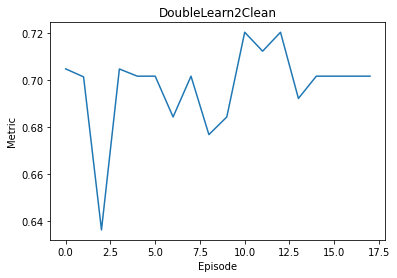

In [19]:
import learn2clean.loading.reader as rd 
import learn2clean.qlearning.qlearner as ql
# the results of learn2clean cleaning are stored in 'titanic_example'_results.txt in 'save' directory

titanic = ["../datasets/titanic/titanic_train.csv","../datasets/titanic/test.csv"]
hr=rd.Reader(sep=',',verbose=False, encoding=False) 
dataset=hr.train_test_split(titanic, 'Survived')


# Learn2clean finds the best strategy LOF -> CART for maximal accuracy : 0.7235772357723578 for CART
# in  234.35 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'CART', 'Survived', None, 'LOF -> CART', 'accuracy', 0.7235772357723578, 234.34766507148743)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='CART', target_goal='Survived',threshold = 0.6, target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.2089381217956543 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> ED -> MM -> IQR -> LDA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.16718602180480957 seconds


>>Duplicate detection and removal:
* For 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.22257423400878906 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02373194694519043 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 689 missing values in ['Cabin', 'Embarked']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1016 missing values in ['Cabin', 'Embarked']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.056210994720458984 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.6958482390285685

Classifica

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.484673023223877 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 689 missing values in ['Cabin', 'Embarked']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1016 missing values in ['Cabin', 'Embarked']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.023849964141845703 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.018084049224853516 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 689 missing values in ['Cabin', 'Em

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

- 0 non-numerical missing values
Imputation done -- CPU time: 0.05374789237976074 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.6947246435229506

Classification done -- CPU time: 0.029076099395751953 seconds
End Pipeline CPU time: 0.08914899826049805 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> ED -> MM -> IQR -> LDA

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.025720834732055664 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.008092164993286133 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test datase

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_search.py:925: UserWarning: One or more of the test scores are non-finite: [nan]
  category=UserWarning
/Users/yassie/opt/anaconda3/e


Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.025190114974975586 seconds
End Pipeline CPU time: 0.07597184181213379 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> MF -> LDA

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.021216154098510742 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Fare', 'Cabin', 'Embarked']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to


Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.0272979736328125 seconds
End Pipeline CPU time: 0.09557294845581055 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> AD -> LDA

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['Pclass', 'Fare', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.013025999069213867 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.18973684310913086 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.21175599098205566 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.01871204376220703 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 689 missing values in ['Cabin', 'Embarked']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1016 missing values in ['Cabin', 'Embarked']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.05092191696166992 seconds


>>Classification task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to


Accuracy of LDA result for 10 cross-validation : 0.6969693152617524

Classification done -- CPU time: 0.027952909469604492 seconds
End Pipeline CPU time: 0.323915958404541 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> LDA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.021857023239135742 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7090909090909091

Classification done -- CPU time: 0.02325916290283203 seconds
End Pipeline CPU time: 0.05365610122680664 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> WR -> AD -> LDA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test da

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_search.py:925: UserWarning: One or more of the test scores are non-finite: [nan]
  category=UserWarning
/Users/yassie/opt/anaconda3/e

176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.02431201934814453 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7181802944740981

Classification done -- CPU time: 0.025136947631835938 seconds
End Pipeline CPU time: 0.05726218223571777 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> AD -> LDA

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.0613400936126709 seconds

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'A

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.1867067813873291 seconds


>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.02738785743713379 seconds
End Pipeline CPU time: 0.22152018547058105 seconds

Start pipeline
-------------

>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.027862071990966797 seconds
End Pipeline CPU time: 0.03153681755065918 seconds

==== Recap ====

List of strategies tried by DoubleLearn2Clean:
['MICE -> ED -> MM -> IQR -> LDA', 'EM -> ZS -> MF -> LDA', 'KNN -> Tree -> EM -> ZS -> MF -> LDA', 'MF -> LDA', 'DS -> ED -> MM -> IQR -> LDA', 'MM -> IQR -> LDA', 'ZS -> MF -> LDA', 'MR -> MM -> IQR -> LDA', 'WR -> AD -> LDA', 'LC -> ZSB -> LDA', 'Tree -> EM -> ZS -> MF -> LDA', 'ZSB -> LDA', 'LOF -> WR -

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

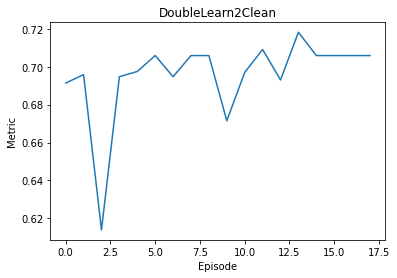

In [20]:
# Learn2clean finds the best strategy WR -> IQR -> LDA for maximal accuracy : 0.7398373983739838 for LDA 
# despite collinearity in  2.68 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'LDA', 'Survived', None, 'ZS -> LOF -> LDA', 'accuracy', 0.7398373983739838, 2.67972993850708)

l2c_c1assification2=ql.Qlearner(dataset,goal='LDA',target_goal='Survived',target_prepare=None, threshold = 0.6, file_name = 'titanic_example', verbose = False)
l2c_c1assification2.learn2clean()



Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.1741492748260498 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> DS -> IQR -> NB

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.1950368881225586 seconds

>>Normalization 
* For train dataset
... train dat

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.5262751579284668 seconds


>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.5859051186017478

Classification done -- CPU time: 0.042131900787353516 seconds
End Pipeline CPU time: 1.574272871017456 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> NB

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin

Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6897077922077922

Classification done -- CPU time: 0.04350018501281738 seconds
End Pipeline CPU time: 0.06931304931640625 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> LOF -> NB

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.056653738021850586 seconds

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU t

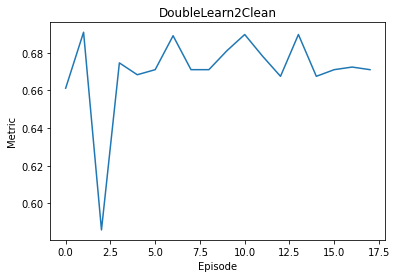

In [21]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='NB',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.14183807373046875 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> ZSB -> LASSO

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.16423702239990234 seconds


>>Outlier detection and removal:
* For train datas

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4986841678619385 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.018680810928344727 seconds


>>Outlier detection and removal:
* For train dataset
13 outlying rows have been removed
* For test dataset
27 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.014124870300292969 seconds


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for cross-validation: 0.2693174271453279
Regression done -- CPU time: 0.019236087799072266 seconds
End Pipeline CPU time: 1.5629801750183105 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> LASSO

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['A


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for cross-validation: 0.23220637080148349
Regression done -- CPU time: 0.023437023162841797 seconds
End Pipeline CPU time: 0.04799818992614746 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> LASSO

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01747584342956543 seconds


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for cross-validation: 0.23123945803625562
Regression done -- CPU time: 0.022702693939208984 seconds
End Pipeline CPU time: 0.04591512680053711 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> LASSO

Start pipelin

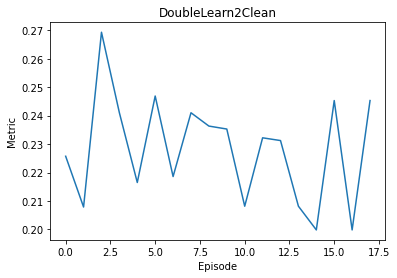

In [22]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='LASSO',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.1602952480316162 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> DS -> IQR -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.16684508323669434 seconds

>>Normalization 
* For train dataset
... train d

const          0.691612
Age           -0.269149
Fare           0.140239
New_ID        -0.008736
Parch          0.083474
PassengerId   -0.008736
Pclass        -0.393779
SibSp         -0.013818
dtype: float64

,const,Age,Fare,New_ID,Parch,PassengerId,Pclass,SibSp
0,1.0,0.259259,0.104204,0.000000,0.000000,0.000000,1.0,0.833333
1,1.0,0.759259,0.882335,0.000765,0.000000,0.000765,0.0,0.833333
2,1.0,0.423670,0.226454,0.001529,0.000000,0.001529,1.0,0.000000
3,1.0,0.703704,0.828578,0.002294,0.000000,0.002294,0.0,0.833333
4,1.0,0.703704,0.244569,0.003058,0.000000,0.003058,1.0,0.000000
...,...,...,...,...,...,...,...,...
1304,1.0,0.439245,0.244569,0.996942,0.000000,0.996942,1.0,0.000000
1305,1.0,0.777778,0.897852,0.997706,0.000000,0.997706,0.0,0.000000
1306,1.0,0.768519,0.104204,0.998471,0.000000,0.998471,1.0,0.000000
1307,1.0,0.439203,0.244569,0.999235,0.000000,0.999235,1.0,0.000000


(8,)

(1309, 8)

(8,)

(1309, 8)

MODIFICATION
Regression done -- CPU time: 0.028023242950439453 seconds
End Pipeline CPU time: 0.24126601219177246 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> Tree -> AD -> MF -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.23038411140441895 seconds


>>Duplicate detection and removal:
* For train dataset
Metric

const          1.003855
Age           -0.005771
Fare           0.000823
Parch          0.051273
PassengerId   -0.000042
Pclass        -0.199996
SibSp         -0.041853
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.000000,7.2500,0.0,1.0,3.0,1.0
1,1.0,38.000000,71.2833,0.0,2.0,1.0,1.0
2,1.0,26.000000,7.9250,0.0,3.0,3.0,0.0
3,1.0,35.000000,53.1000,0.0,4.0,1.0,1.0
4,1.0,35.000000,8.0500,0.0,5.0,3.0,0.0
...,...,...,...,...,...,...,...
1304,1.0,13.021554,8.0500,0.0,1305.0,3.0,0.0
1305,1.0,39.000000,108.9000,0.0,1306.0,1.0,0.0
1306,1.0,38.500000,7.2500,0.0,1307.0,3.0,0.0
1307,1.0,46.498306,8.0500,0.0,1308.0,3.0,0.0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.026163101196289062 seconds
End Pipeline CPU time: 0.5278279781341553 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> DS -> IQR -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.5032730102539062 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.0214540958404541 seconds


>>Outlier detection and removal:
* For train dataset
0 outlying rows have been removed
* For test dataset
0 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01287388801574707 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


const          0.415088
Age           -0.009051
Fare          -0.009051
New_ID        -0.009051
Parch         -0.009051
PassengerId   -0.009051
Pclass        -0.009051
SibSp         -0.009051
dtype: float64

,const,Age,Fare,New_ID,Parch,PassengerId,Pclass,SibSp
0,1.0,0.267314,0.267314,0.267314,0.267314,0.267314,0.267314,0.267314
1,1.0,0.757555,0.757555,0.757555,0.757555,0.757555,0.757555,0.757555
2,1.0,0.442947,0.442947,0.442947,0.442947,0.442947,0.442947,0.442947
3,1.0,0.696887,0.696887,0.696887,0.696887,0.696887,0.696887,0.696887
4,1.0,0.696887,0.696887,0.696887,0.696887,0.696887,0.696887,0.696887
...,...,...,...,...,...,...,...,...
1304,1.0,0.535277,0.535277,0.535277,0.535277,0.535277,0.535277,0.535277
1305,1.0,0.777778,0.777778,0.777778,0.777778,0.777778,0.777778,0.777778
1306,1.0,0.767666,0.767666,0.767666,0.767666,0.767666,0.767666,0.767666
1307,1.0,0.735619,0.735619,0.735619,0.735619,0.735619,0.735619,0.735619


(8,)

(1309, 8)

(8,)

(1309, 8)

MODIFICATION
Regression done -- CPU time: 0.024847030639648438 seconds
End Pipeline CPU time: 1.5747261047363281 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> OLS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.06578993797302246 seconds


>>Regression task


const          1.070316
Age           -0.007349
Fare           0.000780
Parch          0.049035
PassengerId   -0.000016
Pclass        -0.209275
SibSp         -0.043759
New_ID        -0.000016
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
1,1.0,38.0,71.2833,0,2,1,1,2
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
...,...,...,...,...,...,...,...,...
1304,1.0,24.0,8.0500,0,1305,3,0,1305
1305,1.0,39.0,108.9000,0,1306,1,0,1306
1306,1.0,38.5,7.2500,0,1307,3,0,1307
1307,1.0,24.0,8.0500,0,1308,3,0,1308


(8,)

(1309, 8)

(8,)

(1309, 8)

MODIFICATION
Regression done -- CPU time: 0.03244280815124512 seconds
End Pipeline CPU time: 0.10619711875915527 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.03562116622924805 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01990199089050293 seconds


>>Regression task


const          0.721672
Age           -0.313686
Fare           0.121626
New_ID         0.019868
Parch          0.122227
PassengerId    0.019868
Pclass        -0.428701
SibSp         -0.049177
dtype: float64

,const,Age,Fare,New_ID,Parch,PassengerId,Pclass,SibSp
0,1.0,0.296296,0.103943,0.000000,0.000000,0.000000,1.0,0.777778
1,1.0,0.740741,0.865507,0.000766,0.000000,0.000766,0.0,0.777778
2,1.0,0.444444,0.222222,0.001533,0.000000,0.001533,1.0,0.000000
3,1.0,0.685185,0.811804,0.002299,0.000000,0.002299,0.0,0.777778
4,1.0,0.685185,0.227616,0.003065,0.000000,0.003065,1.0,0.000000
...,...,...,...,...,...,...,...,...
1300,1.0,0.019864,0.449694,0.995238,0.777778,0.995238,1.0,0.777778
1302,1.0,0.722222,0.891659,0.996825,0.000000,0.996825,0.0,0.777778
1303,1.0,0.500000,0.126984,0.997619,0.000000,0.997619,1.0,0.000000
1305,1.0,0.759259,0.896508,0.999206,0.000000,0.999206,0.0,0.000000


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.026513099670410156 seconds
End Pipeline CPU time: 0.09337806701660156 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> IQR -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.026814937591552734 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.016812801361083984 seconds


>>Regression task


const          0.933074
Age           -0.682685
Fare           0.286359
New_ID         0.013169
Parch          0.293870
PassengerId    0.013169
Pclass        -0.485845
SibSp         -0.283672
dtype: float64

,const,Age,Fare,New_ID,Parch,PassengerId,Pclass,SibSp
0,1.0,0.273456,0.014151,0.000000,0.000000,0.000000,1.0,0.125
1,1.0,0.473882,0.139136,0.000766,0.000000,0.000766,0.0,0.125
2,1.0,0.323563,0.015469,0.001531,0.000000,0.001531,1.0,0.000
3,1.0,0.436302,0.103644,0.002297,0.000000,0.002297,0.0,0.125
4,1.0,0.436302,0.015713,0.003063,0.000000,0.003063,1.0,0.000
...,...,...,...,...,...,...,...,...
1300,1.0,0.035450,0.026887,0.995406,0.166667,0.995406,1.0,0.125
1302,1.0,0.461355,0.175668,0.996937,0.000000,0.996937,0.0,0.125
1303,1.0,0.348616,0.015176,0.997703,0.000000,0.997703,1.0,0.000
1305,1.0,0.486409,0.212559,0.999234,0.000000,0.999234,0.0,0.000


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.02445077896118164 seconds
End Pipeline CPU time: 0.0776219367980957 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> LOF -> LC -> ZSB -> OLS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02331066131591797 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.022237300872802734 seconds


>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Parch', 'Pclass', 'New

const          0.757093
Age           -0.123731
PassengerId    0.081464
Fare           0.036412
SibSp          0.139956
dtype: float64

,const,Fare,SibSp,PassengerId,Age
512,1.0,-0.135397,-0.478904,-0.375641,0.424523
1,1.0,0.733941,0.481104,-1.727422,0.563282
3,1.0,0.382632,0.481104,-1.722131,0.355144
516,1.0,-0.440419,-0.478904,-0.365060,0.285764
6,1.0,0.358723,-0.478904,-1.714195,1.673353
...,...,...,...,...,...
492,1.0,-0.054010,-0.478904,-0.428549,1.742732
496,1.0,0.868864,0.481104,-0.417967,1.673353
1009,1.0,0.810419,-0.478904,0.939104,0.424523
504,1.0,1.027934,-0.478904,-0.396804,-0.963065


(5,)

(209, 5)

(5,)

(209, 5)

MODIFICATION
Regression done -- CPU time: 0.020570039749145508 seconds
End Pipeline CPU time: 0.11516594886779785 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> MM -> IQR -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
12 features remain
['row', 'Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.006175041198730469 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.029404163360595703 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- 

const          0.933074
Age           -0.682685
Fare           0.286359
New_ID         0.013169
Parch          0.293870
PassengerId    0.013169
Pclass        -0.485845
SibSp         -0.283672
dtype: float64

,const,Age,Fare,New_ID,Parch,PassengerId,Pclass,SibSp
0,1.0,0.273456,0.014151,0.000000,0.000000,0.000000,1.0,0.125
1,1.0,0.473882,0.139136,0.000766,0.000000,0.000766,0.0,0.125
2,1.0,0.323563,0.015469,0.001531,0.000000,0.001531,1.0,0.000
3,1.0,0.436302,0.103644,0.002297,0.000000,0.002297,0.0,0.125
4,1.0,0.436302,0.015713,0.003063,0.000000,0.003063,1.0,0.000
...,...,...,...,...,...,...,...,...
1300,1.0,0.035450,0.026887,0.995406,0.166667,0.995406,1.0,0.125
1302,1.0,0.461355,0.175668,0.996937,0.000000,0.996937,0.0,0.125
1303,1.0,0.348616,0.015176,0.997703,0.000000,0.997703,1.0,0.000
1305,1.0,0.486409,0.212559,0.999234,0.000000,0.999234,0.0,0.000


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.0254971981048584 seconds
End Pipeline CPU time: 0.09125494956970215 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> AD -> MF -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['Pclass', 'Fare', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.012799978256225586 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.1875019073486328 seconds

>>Imputation 
* For train dataset
Before imputation:
No missing values in the given data
* For test dataset
Before imputation:
Total

const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000030
Pclass        -0.242923
SibSp         -0.056734
dtype: float64

,const,Pclass,Fare,SibSp,Parch,PassengerId,Age
0,1.0,3,7.2500,1,0,1,22.0
1,1.0,1,71.2833,1,0,2,38.0
2,1.0,3,7.9250,0,0,3,26.0
3,1.0,1,53.1000,1,0,4,35.0
4,1.0,3,8.0500,0,0,5,35.0
...,...,...,...,...,...,...,...
1304,1.0,3,8.0500,0,0,1305,24.0
1305,1.0,1,108.9000,0,0,1306,39.0
1306,1.0,3,7.2500,0,0,1307,38.5
1307,1.0,3,8.0500,0,0,1308,24.0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.03514814376831055 seconds
End Pipeline CPU time: 0.2705669403076172 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> ZSB -> OLS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp', 'New_ID']
After feature selection:
10 features remain
['row', 'Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.015251874923706055 seconds


>>Outlier detection and removal:
* For train dataset
101 outlying rows have been removed:
* For test dataset
0 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.023096084594726562 seconds


>>Regression task


const          0.380839
Parch          0.081139
PassengerId    0.000005
Fare           0.003496
Age           -0.003503
dtype: float64

,const,Fare,Parch,PassengerId,Age
0,1.0,7.2500,0,1,22.0
1,1.0,71.2833,0,2,38.0
2,1.0,7.9250,0,3,26.0
3,1.0,53.1000,0,4,35.0
4,1.0,8.0500,0,5,35.0
...,...,...,...,...,...
1300,1.0,13.7750,1,1301,3.0
1302,1.0,90.0000,0,1303,37.0
1303,1.0,7.7750,0,1304,28.0
1305,1.0,108.9000,0,1306,39.0


(5,)

(1045, 5)

(5,)

(1045, 5)

MODIFICATION
Regression done -- CPU time: 0.024260997772216797 seconds
End Pipeline CPU time: 0.07427501678466797 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> AD -> MF -> OLS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.20161199569702148 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerica

const          1.070316
Age           -0.007349
Fare           0.000780
Parch          0.049035
PassengerId   -0.000032
Pclass        -0.209275
SibSp         -0.043759
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
1,1.0,38.0,71.2833,0,2,1,1
2,1.0,26.0,7.9250,0,3,3,0
3,1.0,35.0,53.1000,0,4,1,1
4,1.0,35.0,8.0500,0,5,3,0
...,...,...,...,...,...,...,...
1304,1.0,24.0,8.0500,0,1305,3,0
1305,1.0,39.0,108.9000,0,1306,1,0
1306,1.0,38.5,7.2500,0,1307,3,0
1307,1.0,24.0,8.0500,0,1308,3,0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.025291919708251953 seconds
End Pipeline CPU time: 0.2912142276763916 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.02386927604675293 seconds


>>Regression task


const          1.102806
Age           -0.009017
Fare           0.001449
Parch          0.074728
PassengerId   -0.000029
Pclass        -0.202397
SibSp         -0.060265
New_ID        -0.000029
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
1,1.0,38.0,71.2833,0,2,1,1,2
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
...,...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1,1301,3,1,1301
1302,1.0,37.0,90.0000,0,1303,1,1,1303
1303,1.0,28.0,7.7750,0,1304,3,0,1304
1305,1.0,39.0,108.9000,0,1306,1,0,1306


(8,)

(955, 8)

(8,)

(955, 8)

MODIFICATION
Regression done -- CPU time: 0.027430057525634766 seconds
End Pipeline CPU time: 0.05916190147399902 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> LC -> ZSB -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01990818977355957 seconds


>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
4 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Parch', 'Pclass', 'SibSp', 'New_ID']
After feature selection:
9 features remain
['row', 'Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'PassengerId', 'Age']
Feature selec

const          0.838131
PassengerId    0.000169
Fare           0.003382
Age           -0.011326
dtype: float64

,const,Fare,PassengerId,Age
512,1.0,26.2875,513,36.0
1,1.0,71.2833,2,38.0
3,1.0,53.1000,4,35.0
515,1.0,34.0208,516,47.0
516,1.0,10.5000,517,34.0
...,...,...,...,...
496,1.0,78.2667,497,54.0
1009,1.0,75.2417,1010,36.0
1013,1.0,57.7500,1014,35.0
504,1.0,86.5000,505,16.0


(4,)

(181, 4)

(4,)

(181, 4)

MODIFICATION
Regression done -- CPU time: 0.0228118896484375 seconds
End Pipeline CPU time: 0.08816885948181152 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> OLS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.024823665618896484 seconds


>>Regression task


const          0.955088
Age           -0.009580
Fare           0.004793
Parch          0.140806
PassengerId   -0.000008
Pclass        -0.169697
SibSp         -0.029122
New_ID        -0.000008
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
6,1.0,54.0,51.8625,0,7,1,0,7
...,...,...,...,...,...,...,...,...
1296,1.0,20.0,13.8625,0,1297,2,0,1297
1297,1.0,23.0,10.5000,0,1298,2,1,1298
1300,1.0,3.0,13.7750,1,1301,3,1,1301
1303,1.0,28.0,7.7750,0,1304,3,0,1304


(8,)

(829, 8)

(8,)

(829, 8)

MODIFICATION
Regression done -- CPU time: 0.024580001831054688 seconds
End Pipeline CPU time: 0.05628323554992676 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> ZSB -> OLS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.06973791122436523 seconds

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
178 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.020943880081176758 seconds


>>Regression task


const          1.102806
Age           -0.009017
Fare           0.001449
Parch          0.074728
PassengerId   -0.000029
Pclass        -0.202397
SibSp         -0.060265
New_ID        -0.000029
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
2,1.0,26.0,7.9250,0,3,3,0,3
4,1.0,35.0,8.0500,0,5,3,0,5
6,1.0,54.0,51.8625,0,7,1,0,7
7,1.0,2.0,21.0750,1,8,3,3,8
...,...,...,...,...,...,...,...,...
885,1.0,39.0,29.1250,5,886,3,0,886
886,1.0,27.0,13.0000,0,887,2,0,887
887,1.0,19.0,30.0000,0,888,1,0,888
889,1.0,26.0,30.0000,0,890,1,0,890


(8,)

(548, 8)

(8,)

(548, 8)

MODIFICATION
Regression done -- CPU time: 0.023756027221679688 seconds
End Pipeline CPU time: 0.12491083145141602 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ZSB -> OLS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 272
Number of pattern violations on variable

const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000015
Pclass        -0.242923
SibSp         -0.056734
New_ID         0.000015
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
1,1.0,38.0,71.2833,0,2,1,1,2
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
...,...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1,1301,3,1,1301
1302,1.0,37.0,90.0000,0,1303,1,1,1303
1303,1.0,28.0,7.7750,0,1304,3,0,1304
1305,1.0,39.0,108.9000,0,1306,1,0,1306


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.027086734771728516 seconds
End Pipeline CPU time: 0.04684281349182129 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> MF -> OLS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.19643306732177734 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing 

const          1.070316
Age           -0.007349
Fare           0.000780
Parch          0.049035
PassengerId   -0.000032
Pclass        -0.209275
SibSp         -0.043759
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp
0,1.0,22.0,7.2500,0,1,3,1
1,1.0,38.0,71.2833,0,2,1,1
2,1.0,26.0,7.9250,0,3,3,0
3,1.0,35.0,53.1000,0,4,1,1
4,1.0,35.0,8.0500,0,5,3,0
...,...,...,...,...,...,...,...
1304,1.0,24.0,8.0500,0,1305,3,0
1305,1.0,39.0,108.9000,0,1306,1,0
1306,1.0,38.5,7.2500,0,1307,3,0
1307,1.0,24.0,8.0500,0,1308,3,0


(7,)

(1309, 7)

(7,)

(1309, 7)

MODIFICATION
Regression done -- CPU time: 0.02944326400756836 seconds
End Pipeline CPU time: 0.28729772567749023 seconds

Start pipeline
-------------

>>Regression task


const          1.179570
Age           -0.008579
Fare           0.000559
Parch          0.048978
PassengerId    0.000015
Pclass        -0.242923
SibSp         -0.056734
New_ID         0.000015
dtype: float64

,const,Age,Fare,Parch,PassengerId,Pclass,SibSp,New_ID
0,1.0,22.0,7.2500,0,1,3,1,1
1,1.0,38.0,71.2833,0,2,1,1,2
2,1.0,26.0,7.9250,0,3,3,0,3
3,1.0,35.0,53.1000,0,4,1,1,4
4,1.0,35.0,8.0500,0,5,3,0,5
...,...,...,...,...,...,...,...,...
1300,1.0,3.0,13.7750,1,1301,3,1,1301
1302,1.0,37.0,90.0000,0,1303,1,1,1303
1303,1.0,28.0,7.7750,0,1304,3,0,1304
1305,1.0,39.0,108.9000,0,1306,1,0,1306


(8,)

(1045, 8)

(8,)

(1045, 8)

MODIFICATION
Regression done -- CPU time: 0.02435612678527832 seconds
End Pipeline CPU time: 0.027887821197509766 seconds

==== Recap ====

List of strategies tried by DoubleLearn2Clean:
['MICE -> DS -> IQR -> OLS', 'EM -> Tree -> AD -> MF -> OLS', 'KNN -> DS -> IQR -> OLS', 'MF -> OLS', 'DS -> IQR -> OLS', 'MM -> IQR -> OLS', 'ZS -> LOF -> LC -> ZSB -> OLS', 'MR -> MM -> IQR -> OLS', 'WR -> AD -> MF -> OLS', 'LC -> ZSB -> OLS', 'Tree -> AD -> MF -> OLS', 'ZSB -> OLS', 'LOF -> LC -> ZSB -> OLS', 'IQR -> OLS', 'CC -> ZSB -> OLS', 'PC -> ZSB -> OLS', 'ED -> OLS', 'AD -> MF -> OLS']

List of corresponding quality metrics ****
 [{'quality_metric': 0.23677221654749742}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.23677221654749742}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.21326562995874326}, {'quality_metric': 0.24153279825254081}, {'quality_metric': 0.24153279825254081}

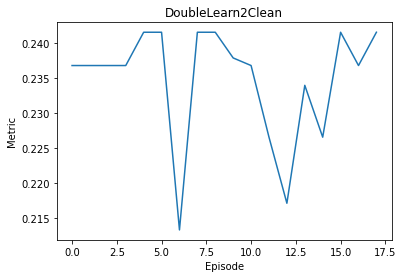

In [23]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='OLS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.17364287376403809 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> LOF -> Tree -> ZSB -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.19839215278625488 seconds


>>Outlier detection and removal:
* F

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.30303476483573605
Regression done -- CPU time: 3.1656620502471924 seconds
End Pipeline CPU time: 3.4203341007232666 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> Tree -> ZSB -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.2487349510192871 seconds


>>Outlier dete

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.31139427624721433
Regression done -- CPU time: 38.163203954696655 seconds
End Pipeline CPU time: 38.443094968795776 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> ED -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.6299901008605957 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.012184858322143555 seconds


>>Regression task
MSE of MARS with 10 folds for cross-validation: 0.3351542198117826
Regression done -- CPU time: 0.10917401313781738 seconds
End Pipeline CPU time: 1.762462854385376 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> MARS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin',

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.06444072723388672 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.314351743650153
Regression done -- CPU time: 0.6239011287689209 seconds
End Pipeline CPU time: 0.6969687938690186 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.03297281265258789 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.019070148468017578 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.3181130073223285
Regression done -- CPU time: 2.7284319400787354 seconds
End Pipeline CPU time: 2.7926900386810303 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> ZSB -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02225208282470703 seconds


>>Outlier detection and removal:
* For train dataset
192 outlying rows have been removed:
* For test dataset
216 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.017255067825317383 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.31552410108475626
Regression done -- CPU time: 0.9167580604553223 seconds
End Pipeline CPU time: 0.9658041000366211 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> AD -> MARS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02811908721923828 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.24998688697814941 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.3169798966942146
Regression done -- CPU time: 0.7719058990478516 seconds
End Pipeline CPU time: 1.0639770030975342 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> MF -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
12 features remain
['row', 'Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.00634002685546875 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 179 missing values in ['Embarked', 'Age']
- 177 numerical missing values in ['Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing valu

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.314351743650153
Regression done -- CPU time: 0.629709005355835 seconds
End Pipeline CPU time: 0.7130868434906006 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> LOF -> Tree -> ZSB -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['Pclass', 'Fare', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.013603925704956055 seconds


>>Outlier detection and removal:
* For train dataset
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.024332046508789062 seconds


>>Outlier detection and removal:
* For train 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.31200828636810674
Regression done -- CPU time: 5.710668087005615 seconds
End Pipeline CPU time: 5.7898149490356445 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> ZSB -> MARS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp', 'New_ID']
After feature selection:
10 features remain
['row', 'Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.015282154083251953 seconds


>>Outlier detection and removal:
* For train dataset
101 outlying rows have been removed:
* For test dataset
0 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.02390122413635254 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:1055: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/li

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.3135049271263277
Regression done -- CPU time: 4.789731979370117 seconds
End Pipeline CPU time: 4.840839862823486 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> ZSB -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.02696394920349121 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.30426971954256776
Regression done -- CPU time: 8.91977596282959 seconds
End Pipeline CPU time: 8.959370851516724 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.030753135681152344 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.30426971954256776
Regression done -- CPU time: 8.919697046279907 seconds
End Pipeline CPU time: 8.959514856338501 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> Tree -> ZSB -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.02292776107788086 seconds


>>Outlier detection and removal:
* For train dataset
17 outlying rows have been removed:
* For test dataset
26 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.022169828414916992 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.315929389091169
Regression done -- CPU time: 2.7808279991149902 seconds
End Pipeline CPU time: 2.8392341136932373 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> MARS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.023500919342041016 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.30524564000559257
Regression done -- CPU time: 1.249640941619873 seconds
End Pipeline CPU time: 1.2795960903167725 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> ZSB -> MARS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.06702184677124023 seconds

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
178 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.023246049880981445 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

MSE of MARS with 10 folds for cross-validation: 0.30426971954256776
Regression done -- CPU time: 8.782700061798096 seconds
End Pipeline CPU time: 8.88503885269165 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> ED -> MARS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern#

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.3163411289963457
Regression done -- CPU time: 0.8593630790710449 seconds
End Pipeline CPU time: 0.8860290050506592 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> MARS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.23322296142578125 seconds


>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.3163411289963457
Regression done -- CPU time: 0.8325908184051514 seconds
End Pipeline CPU time: 1.0735499858856201 seconds

Start pipeline
-------------

>>Regression task


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:1055: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/li

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

MSE of MARS with 10 folds for cross-validation: 0.3163411289963457
Regression done -- CPU time: 0.8599090576171875 seconds
End Pipeline CPU time: 0.864326000213623 seconds

==== Recap ====

List of strategies tried by DoubleLearn2Clean:
['MICE -> LOF -> Tree -> ZSB -> MARS', 'EM -> Tree -> ZSB -> MARS', 'KNN -> ED -> MARS', 'MF -> MARS', 'DS -> IQR -> MARS', 'MM -> ZSB -> MARS', 'ZS -> AD -> MARS', 'MR -> MF -> MARS', 'WR -> LOF -> Tree -> ZSB -> MARS', 'LC -> ZSB -> MARS', 'Tree -> ZSB -> MARS', 'ZSB -> MARS', 'LOF -> Tree -> ZSB -> MARS', 'IQR -> MARS', 'CC -> ZSB -> MARS', 'PC -> ED -> MARS', 'ED -> MARS', 'AD -> MARS']

List of corresponding quality metrics ****
 [{'quality_metric': 0.30303476483573605}, {'quality_metric': 0.31139427624721433}, {'quality_metric': 0.3351542198117826}, {'quality_metric': 0.314351743650153}, {'quality_metric': 0.3181130073223285}, {'quality_metric': 0.31552410108475626}, {'quality_metric': 0.3169798966942146}, {'quality_metric': 0.314351743650153}, {'

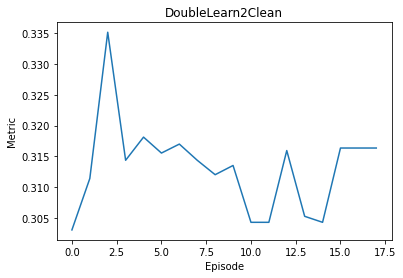

In [24]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='MARS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.20717406272888184 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> WR -> ZSB -> HCA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.41507601737976074 seconds


>>Feature selection 
Before feature selection:

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.6286258697509766 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.017206192016601562 seconds


>>Outlier detection and removal:
* For train dataset
13 outlying rows have been removed
* For test dataset
27 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.014650106430053711 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5559  for k= 3
Quality of clustering 0.5559
Clustering done -- CPU time: 0.10702776908874512 seconds
End Pipeline CPU time: 1.7806708812713623 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> HCA

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 1

178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.027019023895263672 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.
Best silhouette = 0.5668  for k= 5
Quality of clustering 0.5668
Clustering done -- CPU time: 0.05764937400817871 seconds
End Pipeline CPU time: 0.09261274337768555 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> LC -> ZSB -> HCA

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.019774436950683594 seconds


>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selecti

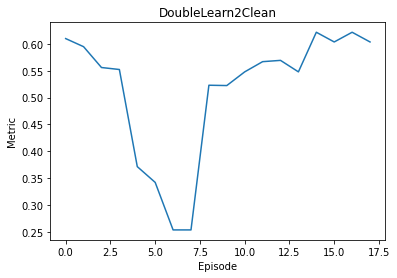

In [25]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='HCA',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

Start DoubleLearn2Clean
DoubleLearn2Clean - Pipeline construction -- CPU time: 0.17200994491577148 seconds
=== Start Pipeline Execution ===


Strategy# 0 : Greedy traversal for starting state MICE
MICE -> ZSB -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.16308903694152832 seconds


>>Outlier detection and removal:
* For train data

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6169  for k= 2
Quality of clustering 0.6169
Clustering done -- CPU time: 0.2323319911956787 seconds
End Pipeline CPU time: 0.42086315155029297 seconds


Strategy# 1 : Greedy traversal for starting state EM
EM -> Tree -> DS -> IQR -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.23862600326538086 seconds

>>Normali

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.3108  for k= 3
Quality of clustering 0.3108
Clustering done -- CPU time: 0.2832169532775879 seconds
End Pipeline CPU time: 0.5726108551025391 seconds


Strategy# 2 : Greedy traversal for starting state KNN
KNN -> DS -> IQR -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Inp

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.546492338180542 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.022417783737182617 seconds


>>Outlier detection and removal:
* For train dataset
0 outlying rows have been removed
* For test dataset
0 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.015440940856933594 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6412  for k= 2
Quality of clustering 0.6412
Clustering done -- CPU time: 0.19573354721069336 seconds
End Pipeline CPU time: 1.7953016757965088 seconds


Strategy# 3 : Greedy traversal for starting state MF
MF -> KMEANS

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 0 missing values
- 0 numerical missing values
- 0 non-numerical missing values
Imputation done -- CPU time: 0.07547402381896973 seconds


>>Clustering task
Note: The clustering 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6067  for k= 2
Quality of clustering 0.6067
Clustering done -- CPU time: 0.29183101654052734 seconds
End Pipeline CPU time: 0.37568116188049316 seconds


Strategy# 4 : Greedy traversal for starting state DS
DS -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.0307009220123291 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.021216869354248047 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.2971  for k= 3
Quality of clustering 0.2971
Clustering done -- CPU time: 0.2376539707183838 seconds
End Pipeline CPU time: 0.30182409286499023 seconds


Strategy# 5 : Greedy traversal for starting state MM
MM -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.025506019592285156 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01895880699157715 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.3497  for k= 3
Quality of clustering 0.3497
Clustering done -- CPU time: 0.2281041145324707 seconds
End Pipeline CPU time: 0.2837698459625244 seconds


Strategy# 6 : Greedy traversal for starting state ZS
ZS -> Tree -> DS -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.03079819679260254 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.024657011032104492 seconds


>>Outlier detection and removal:
* For train dataset
12 outlying rows have been removed
* For test dataset
18 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01799297332763672 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.3022  for k= 3
Quality of clustering 0.3022
Clustering done -- CPU time: 0.21667814254760742 seconds
End Pipeline CPU time: 0.3102750778198242 seconds


Strategy# 7 : Greedy traversal for starting state MR
MR -> MICE -> ZSB -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
12 features remain
['row', 'Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.006834983825683594 seconds

>>Imputation 
* For train dataset
Before imputation:
Total 179 missing values in ['Embarked', 'Age']
- 177 numerical missing values in ['Age']
- 2 non-numerical missing values in ['Embarked']
After imputation:
Total 2 missing values
- 0 numerical missing values
- 2 non-numerical mi

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6169  for k= 2
Quality of clustering 0.6169
Clustering done -- CPU time: 0.22092604637145996 seconds
End Pipeline CPU time: 0.6704161167144775 seconds


Strategy# 8 : Greedy traversal for starting state WR
WR -> DS -> IQR -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only applied to positive variables.
After feature selection:
7 features remain
['Pclass', 'Fare', 'New_ID', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.014143943786621094 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.030184030532836914 seconds


>>Outlier detection and removal:
* For train dataset
0 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01789021

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.2971  for k= 3
Quality of clustering 0.2971
Clustering done -- CPU time: 0.23279309272766113 seconds
End Pipeline CPU time: 0.3079860210418701 seconds


Strategy# 9 : Greedy traversal for starting state LC
LC -> ZSB -> KMEANS

Start pipeline
-------------

>>Feature selection 
Before feature selection:
13 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp', 'New_ID']
After feature selection:
10 features remain
['row', 'Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.0152587890625 seconds


>>Outlier detection and removal:
* For train dataset
101 outlying rows have been removed:
* For test dataset
0 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.024094820022583008 seconds


>>Clustering task
Note: The clustering is applied on the trainin

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6045  for k= 2
Quality of clustering 0.6045
Clustering done -- CPU time: 0.23154997825622559 seconds
End Pipeline CPU time: 0.28351283073425293 seconds


Strategy# 10 : Greedy traversal for starting state Tree
Tree -> DS -> IQR -> KMEANS

Start pipeline
-------------
>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.029683828353881836 seconds


>>Outlier detection and removal:
* For train dataset
177 outlying rows have been removed
* For test dataset
264 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.01899099349975586 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.2971  for k= 3
Quality of clustering 0.2971
Clustering done -- CPU time: 0.2304389476776123 seconds
End Pipeline CPU time: 0.2958409786224365 seconds


Strategy# 11 : Greedy traversal for starting state ZSB
ZSB -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
178 outlying rows have been removed:
* For test dataset
90 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.024665117263793945 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6226  for k= 2
Quality of clustering 0.6226
Clustering done -- CPU time: 0.22174811363220215 seconds
End Pipeline CPU time: 0.255173921585083 seconds


Strategy# 12 : Greedy traversal for starting state LOF
LOF -> ED -> MF -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.02222895622253418 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 153
After deduplication: Number of rows: 153
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 240
After deduplication: Number of rows: 240
Deduplication done -- CPU time: 0.009294986724853516 s

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Quality of clustering 0.5747
Clustering done -- CPU time: 0.13410687446594238 seconds
End Pipeline CPU time: 0.18684601783752441 seconds


Strategy# 13 : Greedy traversal for starting state IQR
IQR -> KMEANS

Start pipeline
-------------

>>Outlier detection and removal:
* For train dataset
176 outlying rows have been removed
* For test dataset
239 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.027420997619628906 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Best silhouette = 0.623  for k= 2
Quality of clustering 0.623
Clustering done -- CPU time: 0.21677684783935547 seconds
End Pipeline CPU time: 0.25260329246520996 seconds


Strategy# 14 : Greedy traversal for starting state CC
CC -> KMEANS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 51

Constraints failing: 5

* For test dataset
Constraints from the file: titanic_example_constraints.tdda
Constraints passing: 46

Constraints failing: 10

Consistency checking done -- CPU time: 0.07258224487304688 seconds

>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6104  for k= 2
Quality of clustering 0.6104
Clustering done -- CPU time: 0.23981475830078125 seconds
End Pipeline CPU time: 0.3210728168487549 seconds


Strategy# 15 : Greedy traversal for starting state PC
PC -> IQR -> KMEANS

Start pipeline
-------------
>>Consistency checking
* For train dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 891
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for pattern# 0 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 1 : 170
Number of pattern violations on variable ' Embarked 'for pattern# 2 : 247
No record from the dataset satisfied the patterns!
Will return empty dataset - please change our patterns
* For test dataset
Number of pattern violations on variable ' Sex 'for pattern# 0 : 1309
No violation on variable ' Sex ' for pattern# 1 as '^[a-z]{4,6}$'
Number of pattern violations on variable ' Embarked 'for patte

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6067  for k= 2
Quality of clustering 0.6067
Clustering done -- CPU time: 0.2847471237182617 seconds
End Pipeline CPU time: 0.3760256767272949 seconds


Strategy# 17 : Greedy traversal for starting state AD
AD -> ZSB -> KMEANS

Start pipeline
-------------

>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'AD'.
Number of duplicate rows removed: 0
* For test dataset
Metric is not considered for 'AD'.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


Number of duplicate rows removed: 0
Deduplication done -- CPU time: 0.3057210445404053 seconds


>>Outlier detection and removal:
* For train dataset
338 outlying rows have been removed:
* For test dataset
398 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.02340388298034668 seconds


>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6335  for k= 2
Quality of clustering 0.6335
Clustering done -- CPU time: 0.21775293350219727 seconds
End Pipeline CPU time: 0.558621883392334 seconds

Start pipeline
-------------

>>Clustering task
Note: The clustering is applied on the training dataset only.


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6104  for k= 2
Quality of clustering 0.6104
Clustering done -- CPU time: 0.2516360282897949 seconds
End Pipeline CPU time: 0.256148099899292 seconds

==== Recap ====

List of strategies tried by DoubleLearn2Clean:
['MICE -> ZSB -> KMEANS', 'EM -> Tree -> DS -> IQR -> KMEANS', 'KNN -> DS -> IQR -> KMEANS', 'MF -> KMEANS', 'DS -> IQR -> KMEANS', 'MM -> IQR -> KMEANS', 'ZS -> Tree -> DS -> IQR -> KMEANS', 'MR -> MICE -> ZSB -> KMEANS', 'WR -> DS -> IQR -> KMEANS', 'LC -> ZSB -> KMEANS', 'Tree -> DS -> IQR -> KMEANS', 'ZSB -> KMEANS', 'LOF -> ED -> MF -> KMEANS', 'IQR -> KMEANS', 'CC -> KMEANS', 'PC -> IQR -> KMEANS', 'ED -> MF -> KMEANS', 'AD -> ZSB -> KMEANS']

List of corresponding quality metrics ****
 

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)


[{'quality_metric': 0.6169, 'result': {'train':            Age     Fare  Parch  PassengerId  Pclass  SibSp  New_ID  cluster_ID
0    22.000000   7.2500    0.0          1.0     3.0    1.0     1.0           0
2    26.000000   7.9250    0.0          3.0     3.0    0.0     3.0           0
4    35.000000   8.0500    0.0          5.0     3.0    0.0     5.0           0
5    27.456870   8.4583    0.0          6.0     3.0    0.0     6.0           0
8    27.000000  11.1333    2.0          9.0     3.0    0.0     9.0           0
..         ...      ...    ...          ...     ...    ...     ...         ...
886  27.000000  13.0000    0.0        887.0     2.0    0.0   887.0           1
887  19.000000  30.0000    0.0        888.0     1.0    0.0   888.0           1
888  21.078369  23.4500    2.0        889.0     3.0    1.0   889.0           1
889  26.000000  30.0000    0.0        890.0     1.0    0.0   890.0           1
890  32.000000   7.7500    0.0        891.0     3.0    0.0   891.0           1

[67

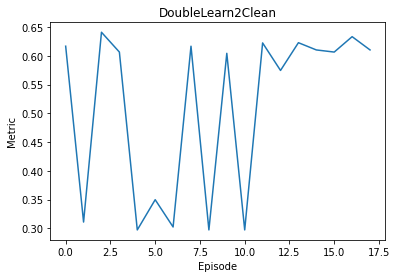

In [26]:
# Learn2clean finds the best strategy WR -> IQR -> NB for maximal accuracy : 0.7052631578947368 for NB
# in  2.96 seconds
# The best strategy is stored in EOF of 'titanic_example_results.txt' in 'save' directory as
# ('titanic_example', 'learn2clean', 'NB', 'Survived', None, 'Tree -> IQR -> NB', 'accuracy', 0.7052631578947368, 2.9261510372161865)

l2c_c1assification1=ql.Qlearner(dataset = dataset,goal='KMEANS',target_goal='Survived',threshold = 0.6,target_prepare=None, file_name = 'titanic_example', verbose = False)
l2c_c1assification1.learn2clean()

## Random data preprocessing pipelines

In [28]:
import learn2clean.loading.reader as rd 
import learn2clean.qlearning.qlearner as ql

titanic = ["../datasets/titanic/titanic_train.csv","../datasets/titanic/test.csv"]
hr=rd.Reader(sep=',',verbose=False, encoding=False) 
dataset=hr.train_test_split(titanic, 'Survived')


# random preprocessing pipeline for classification ; 
# the results of random cleaning are stored in 'titanic_example'_results_file.txt in 'save' directory
# appended to the EOF but random cleaning may raise errors and have no result

#random preprocessing pipeline for CART classification
random1=ql.Qlearner(dataset = dataset,goal='CART',target_goal='Survived',target_prepare=None, verbose = False)
random1.random_cleaning('titanic_example')

#random preprocessing pipeline for LDA classification
random2=ql.Qlearner(dataset,goal='LDA',target_goal='Survived',target_prepare=None, verbose = True)
random2.random_cleaning('titanic_example')

#random preprocessing pipeline for NB classification
random3=ql.Qlearner(dataset,goal='NB',target_goal='Survived', threshold=0.6, target_prepare=None, verbose = False)
random3.random_cleaning('titanic_example')

random4=ql.Qlearner(dataset = dataset,goal='LASSO',target_goal='Survived',target_prepare=None, verbose = False)
random4.random_cleaning('titanic_example')

random5=ql.Qlearner(dataset = dataset,goal='OLS',target_goal='Survived',target_prepare=None, verbose = False)
random5.random_cleaning('titanic_example')

random6=ql.Qlearner(dataset = dataset,goal='MARS',target_goal='Survived',target_prepare=None, verbose = False)
random6.random_cleaning('titanic_example')

random7=ql.Qlearner(dataset = dataset,goal='HCA',target_goal='Survived',target_prepare=None, verbose = False)
random7.random_cleaning('titanic_example')

random8=ql.Qlearner(dataset = dataset,goal='KMEANS',target_goal='Survived',target_prepare=None, verbose = False)
random8.random_cleaning('titanic_example')





--------------------------
Random cleaning strategy:
 EM -> WR -> IQR -> ED -> CART
--------------------------

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.24042272567749023 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply WR feature selection
Input variables must be non-negative. WR feature selection is only a

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.4410960674285889 seconds

>>Normalization 
* For train dataset
MM normalizing...
... train dataset
* For test dataset
MM normalizing...
... test dataset
Normalization done -- CPU time: 0.018954038619995117 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
             missing_fraction
Cabin                0.771044
Embarked             0.002245
Age                  0.000000
Fare                 0.000000
Parch                0.000000
PassengerId          0.000000
Pclass               0.000000
SibSp                0.000000
Name                 0.000000
Sex                  0.000000
Ticket               0.000000
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
List of variables to be keep
['Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to

After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.1658921241760254 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.024175167083740234 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply LC feature selection with threshold= 0.3
3 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Parch', 'Pclass', 'SibSp']
After feature selection:
8 features remain
['Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.012012958526611328 seconds


>>Outlier detection and removal:
* For train dataset
LOF requires no missing values, so missing values have been removed using DROP.
30 outlying rows have been removed
* For test dataset
LOF requires no missing values, so missing values have been removed us

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.337123155593872 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.0206148624420166 seconds


>>Outlier detection and removal:
* For train dataset
0 outlying rows have been removed
* For test dataset
0 outlying rows have been removed
Outlier detection and removal done -- CPU time: 0.013293981552124023 seconds


>>Duplicate detection and removal:
* For train dataset
Metric is not considered for 'ED'.
Initial number of rows: 891
After deduplication: Number of rows: 891
* For test dataset
Metric is not considered for 'ED'.
Initial number of rows: 1309
After deduplication: Number of rows: 1309
Deduplication done -- CPU time: 0.006762027740478516 seconds


>>Regression task
Best alpha =  0.001
MSE of LASSO with 10  folds for cross-validation: 0.28050750544881564
Regressio

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.3222222328186035 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.02032613754272461 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.005006074905395508 seconds


>>Outlier detection and removal:
* For train dataset
164 outlying rows have been removed:
* For test dataset
246 outlying rows have been removed:
Outlier detection and removal done -- CPU time: 0.01743316650390625 seconds


>>Regression task


const          0.353506
Pclass         0.004573
Fare           0.004573
SibSp          0.004573
Parch          0.004573
PassengerId    0.004573
Age            0.004573
dtype: float64

,const,Pclass,Fare,SibSp,Parch,PassengerId,Age
0,1.0,0.273456,0.273456,0.273456,0.273456,0.273456,0.273456
1,1.0,0.473882,0.473882,0.473882,0.473882,0.473882,0.473882
2,1.0,0.323563,0.323563,0.323563,0.323563,0.323563,0.323563
3,1.0,0.436302,0.436302,0.436302,0.436302,0.436302,0.436302
4,1.0,0.436302,0.436302,0.436302,0.436302,0.436302,0.436302
...,...,...,...,...,...,...,...
1304,1.0,0.366444,0.366444,0.366444,0.366444,0.366444,0.366444
1305,1.0,0.486409,0.486409,0.486409,0.486409,0.486409,0.486409
1306,1.0,0.480145,0.480145,0.480145,0.480145,0.480145,0.480145
1307,1.0,0.458090,0.458090,0.458090,0.458090,0.458090,0.458090


(7,)

(1063, 7)

(7,)

(1063, 7)

MODIFICATION
Regression done -- CPU time: 0.04442334175109863 seconds
End Pipeline CPU time: 1.426614761352539 seconds
('titanic_example', 'random', 'OLS', 'Survived', None, 'KNN -> MM -> MR -> ZSB -> OLS', 'MSE', ({'quality_metric': 0.23158684506690008}, 1.426614761352539))


--------------------------
Random cleaning strategy:
 KNN -> ZS -> MR -> MARS
--------------------------

Start pipeline
-------------
>>Imputation 
* For train dataset
Before imputation:
Total 866 missing values in ['Age', 'Cabin', 'Embarked']
- 177 numerical missing values in ['Age']
- 689 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("I

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/fancyimpute/solver.py:55: UserWarning: Input matrix is not missing any values
  warnings.warn("Input matrix is not missing any values")


After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 1.3337748050689697 seconds

>>Normalization 
* For train dataset
... train dataset
* For test dataset
... test dataset
Normalization done -- CPU time: 0.017853975296020508 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply MR feature selection with missing threshold= 0.3
1 features with greater than 0.30 missing values.

List of variables to be removed : ['Cabin']
After feature selection:
10 features remain
['Ticket', 'Pclass', 'Sex', 'Embarked', 'Fare', 'Name', 'SibSp', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.004995107650756836 seconds


>>Regression task
MSE of MARS with 10 folds for cross-validation: 0.3372231363618816
Regression done -- CPU time: 0.11301302909851074 seconds
End Pipeline CPU time: 1.4825708866119385 seconds
('titanic_example', 'random', 'MARS', 'Survived', None, 'KNN -> ZS -> M

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_contrib_py_earth-0.1.0-py3.6-macosx-10.9-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn_co

After imputation:
Total 689 missing values
- 0 numerical missing values
- 689 non-numerical missing values
* For test dataset
Before imputation:
Total 1280 missing values in ['Age', 'Cabin', 'Embarked', 'Fare']
- 264 numerical missing values in ['Age', 'Fare']
- 1016 non-numerical missing values in ['Cabin', 'Embarked']
After imputation:
Total 1016 missing values
- 0 numerical missing values
- 1016 non-numerical missing values
Imputation done -- CPU time: 0.22645092010498047 seconds


>>Feature selection 
Before feature selection:
11 features 
Apply LC feature selection with threshold= 0.3
2 features with linear correlation greater than 0.30.

List of correlated variables to be removed : ['Pclass', 'SibSp']
After feature selection:
9 features remain
['Ticket', 'Sex', 'Embarked', 'Cabin', 'Fare', 'Name', 'Parch', 'PassengerId', 'Age']
Feature selection done -- CPU time: 0.011902809143066406 seconds


>>Outlier detection and removal:
* For train dataset
165 outlying rows have been remove

/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/cluster/_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " remo

Best silhouette = 0.6151  for k= 2
Quality of clustering 0.6151
Clustering done -- CPU time: 0.2128293514251709 seconds
End Pipeline CPU time: 0.515052080154419 seconds
('titanic_example', 'random', 'KMEANS', 'Survived', None, 'EM -> MF -> IQR -> KMEANS', 'silhouette', ({'quality_metric': 0.6151, 'result': {'train':            Age     Fare  Parch  PassengerId  Pclass  SibSp  cluster_ID
0    22.000000   7.2500    0.0          1.0     3.0    1.0           0
2    26.000000   7.9250    0.0          3.0     3.0    0.0           0
3    35.000000  53.1000    0.0          4.0     1.0    1.0           0
4    35.000000   8.0500    0.0          5.0     3.0    0.0           0
5    31.173413   8.4583    0.0          6.0     3.0    0.0           0
..         ...      ...    ...          ...     ...    ...         ...
884  25.000000   7.0500    0.0        885.0     3.0    0.0           1
886  27.000000  13.0000    0.0        887.0     2.0    0.0           1
887  19.000000  30.0000    0.0        888.0

{'quality_metric': 0.6151,
 'result': {'train':            Age     Fare  Parch  PassengerId  Pclass  SibSp  cluster_ID
  0    22.000000   7.2500    0.0          1.0     3.0    1.0           0
  2    26.000000   7.9250    0.0          3.0     3.0    0.0           0
  3    35.000000  53.1000    0.0          4.0     1.0    1.0           0
  4    35.000000   8.0500    0.0          5.0     3.0    0.0           0
  5    31.173413   8.4583    0.0          6.0     3.0    0.0           0
  ..         ...      ...    ...          ...     ...    ...         ...
  884  25.000000   7.0500    0.0        885.0     3.0    0.0           1
  886  27.000000  13.0000    0.0        887.0     2.0    0.0           1
  887  19.000000  30.0000    0.0        888.0     1.0    0.0           1
  889  26.000000  30.0000    0.0        890.0     1.0    0.0           1
  890  32.000000   7.7500    0.0        891.0     3.0    0.0           1
  
  [673 rows x 7 columns],
  'test':             Age     Fare  Parch  Passen

In [29]:
# no preprocessing: results appended to the EOF 'titanic_example'_results.txt 


no_prep1=ql.Qlearner(dataset = dataset,goal='CART',target_goal='Survived',target_prepare=None, verbose = False)
no_prep1.no_prep('titanic_example')

no_prep2=ql.Qlearner(dataset = dataset,goal='LDA',target_goal='Survived',target_prepare=None, verbose = False)
no_prep2.no_prep('titanic_example')

no_prep3=ql.Qlearner(dataset = dataset,goal='NB',target_goal='Survived',target_prepare=None, verbose = False)
no_prep3.no_prep('titanic_example')


Start pipeline
-------------

>>Classification task
Avg accuracy of CART classification for 10 cross-validation : 0.7017410015649452

Classification done -- CPU time: 21.588985919952393 seconds
End Pipeline CPU time: 21.617291927337646 seconds

Start pipeline
-------------

>>Classification task

Accuracy of LDA result for 10 cross-validation : 0.7058823529411764

Classification done -- CPU time: 0.054556846618652344 seconds
End Pipeline CPU time: 0.057524919509887695 seconds

Start pipeline
-------------

>>Classification task
Accuracy of Naive Naive Bayes classification for 10 cross-validation : 0.6682511737089201

Classification done -- CPU time: 0.0504298210144043 seconds
End Pipeline CPU time: 0.05370187759399414 seconds


/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/discriminant_analysis.py", line 540, in fit
    "n_components cannot be larger than min(n_features, "
ValueError: n_components cannot be larger than min(n_features, n_classes - 1).

  FitFailedWarning)
/Users/yassie/opt/anaconda3/envs/l2cbatates/lib/python3.6/site-packages/sklearn/model_selection/_validation.py:619: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to